# Generative Learning

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/cihan-ates/data-driven-engineering/blob/master/DDE_I_ML_Dynamical_Systems/Lecture%2011/Lecture_9.ipynb)


# Important Note

Lecture notes and notebooks must not be copied and/or distributed without the express permission of ITS.





# 1. Problem Definition: Probe into the Data

In this dataset, we will dive into 6 Violin Sonatas and Partitas (Bach Werke Verzeichnis 1001-1006) by the renowned german composer Johann Sebastian Bach. Despite his beautiful work, which in today's world is considered an essential for any growing musician, for most of his pieces it took nearly a 100 years to get popularized. Therefore, only after his death in the 19th century he started to receive the recognition that he deserved.
Bach himself being a violinist, the 6 Sonatas and Partitias contain some of the most masterly and expressive works ever written for solo violin.

Today, we will use parts of his legacy to become composers ourselves by the means of generative learning.


# 2. Preparing the enviroment

Import the Python libraries that we will need to (i) load the data, (ii) analyze it, (iii) create our model, (iv) process the results.

In [ ]:
# Loading libraries:
#
#Fundamentals
import numpy as np
import pandas as pd
import os
#
# Aux. libs:
import matplotlib.pyplot as plt
from IPython import display
from IPython.display import clear_output
import glob
import imageio
import time
import IPython.display as ipd
#
# audio processing
import librosa
#
#ML libraries
import tensorflow as tf
#import tensorflow_addons as tfa
from tensorflow.keras import layers, utils
AUTOTUNE = tf.data.experimental.AUTOTUNE

In [ ]:
from music21 import converter, instrument, note, stream, chord, duration


In [ ]:
#!apt-get install musescore

In [ ]:
!pip install ipython-autotime
%load_ext autotime

time: 177 µs (started: 2022-01-17 09:02:21 +00:00)


# 3. Pre-processing


## Loading the Data

In [ ]:
# Loading the data
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

time: 17.3 s (started: 2022-01-17 09:02:27 +00:00)


In [ ]:
downloaded = drive.CreateFile({'id':'15w-FbZF-_w-AMwEYEjio8-g8LSlDXsrp'}) 
downloaded.GetContentFile('solo_violin.zip')
!unzip solo_violin.zip 
!ls

Archive:  solo_violin.zip
   creating: solo_violin/
  inflating: solo_violin/vp1-1al.mid  
  inflating: solo_violin/vp1-2ald.mid  
  inflating: solo_violin/vp1-3co.mid  
  inflating: solo_violin/vp1-4cod.mid  
  inflating: solo_violin/vp1-5sa.mid  
  inflating: solo_violin/vp1-6sad.mid  
  inflating: solo_violin/vp1-7tb.mid  
  inflating: solo_violin/vp1-8tbd.mid  
  inflating: solo_violin/vp2-1all.mid  
  inflating: solo_violin/vp2-2cou.mid  
  inflating: solo_violin/vp2-3sar.mid  
  inflating: solo_violin/vp2-4gig.mid  
  inflating: solo_violin/vp2-5cha.mid  
  inflating: solo_violin/vp3-1pre.mid  
  inflating: solo_violin/vp3-2lou.mid  
  inflating: solo_violin/vp3-3gav.mid  
  inflating: solo_violin/vp3-4min.mid  
  inflating: solo_violin/vp3-5bou.mid  
  inflating: solo_violin/vp3-6gig.mid  
  inflating: solo_violin/vs1-1ada.mid  
  inflating: solo_violin/vs1-2fug.mid  
  inflating: solo_violin/vs1-3sic.mid  
  inflating: solo_violin/vs1-4prs.mid  
  inflating: solo_violin/vs2-1gr

In [ ]:
#For MIDI conversion:
!apt install fluidsynth
!cp /usr/share/sounds/sf2/FluidR3_GM.sf2 ./font.sf2
!pip install midi2audio
#Calling libs:
from midi2audio import FluidSynth
from IPython.display import Audio

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  fluid-soundfont-gm libfluidsynth1 libqt5x11extras5 qsynth
Suggested packages:
  fluid-soundfont-gs timidity jackd
The following NEW packages will be installed:
  fluid-soundfont-gm fluidsynth libfluidsynth1 libqt5x11extras5 qsynth
0 upgraded, 5 newly installed, 0 to remove and 37 not upgraded.
Need to get 120 MB of archives.
After this operation, 150 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fluid-soundfont-gm all 3.1-5.1 [119 MB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libfluidsynth1 amd64 1.1.9-1 [137 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fluidsynth amd64 1.1.9-1 [20.7 kB]
Get:4 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libqt5x11extras5 amd64 5.9.5-0ubuntu1 [8,596 B]
Get:5 http://archive.ubuntu.com/ubuntu bionic/uni

In [ ]:
physical_devices = tf.config.list_physical_devices('GPU')
tf.config.experimental.set_memory_growth(physical_devices[0], enable=True)

time: 254 ms (started: 2022-01-17 09:03:25 +00:00)


## Converting Music into our Input Matrix

A **note** can be understood as a symbolic representation of a sound, which is described by its **pitch** (in combination with the clef) and **duration**. A note's pitch is related to the frequency of oscillation of its sound wave, measured in hertz (Hz). For instance, notes with higher pitches have sound waves with more oscillations per second. A note's duration, on the other hand, is the length of the period over which it is played.

A **chord** is a combination of multiple (at least two, but mostly three) notes with different intervals played simultaneously on the same instrument. For a single instrument, we can identify chords by assuming that all notes played at the exact same time are part of the same chord. This simplifying assumption is not valid if we have polyphonic music, that is, if we have two or more instruments playing simultaneously.

**How are we going to use notes?**

Musical data is needed to be processed before feeding it into any ML algorithm. The conversion is naturally linked to the original form of the dataset. You can, for example, 'listen' to mp3 files and learn to compose by just 'listening' (below I added an example with VAE). The alternative is to use the mathematics of music and notes. We will follow the second way.

We will convert the musical information first into a **string**. Then, we will **encode the data**. For that purpose, we will use a function that can **convert each note into two as the pitch and duration**. 

Our model will learn to **predict the right amount of pitch and duration** simultaneously for the next step. 






For data processing, we are relying on `music21` library to load the MIDI files into Python enviroment. For MIDI, see: 

https://en.wikipedia.org/wiki/MIDI

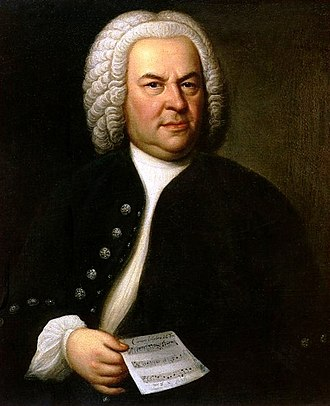

Below, is an illustration of the content of a single example in our dataset ('vp1-1al'). Data is taken from ["Sonatas and Partitas for Solo Violin"](http://www.jsbach.net/midi/midi_solo_violin.html)from JS Bach.

In [ ]:
#Example on how to use music21 library:
dataset_name = 'solo_violin'
filename = 'vp1-1al'
file = "./{}/{}.mid".format(dataset_name, filename)
original_piece = converter.parse(file).chordify()

time: 2.64 s (started: 2022-01-17 09:03:25 +00:00)


First, we have imported the `converter` module, which we used to parse MIDI file 'vp1-1al'. 

Then, we called the `chordify()` method. It is just a made-up word created in `music21` for the process of making chords out of non-chords. Basically it collapses all simultaneously played notes into chords within a single part. 

For illustration:
https://web.mit.edu/music21/doc/usersGuide/usersGuide_09_chordify.html

Remember: since we have only one instrument, it is okay to do so. For polyphonic music, we have to follow a different path. 

In [ ]:
# On your local setup, you can also display the sheet music by using MuseScore:
# you will also need it to listen to your art!
#https://musescore.org/en

time: 1.47 ms (started: 2022-01-17 09:03:28 +00:00)


In [ ]:
#See as an object:
original_piece

<music21.stream.Part 0x7f6fc32a7990>

time: 4.27 ms (started: 2022-01-17 09:03:28 +00:00)


In [ ]:
#Lets see how it looks:
#Pay special attention to first lines.
original_piece[:10].show('text')

{0.0} <music21.instrument.Violin Violin>
{0.0} <music21.tempo.MetronomeMark Quarter=250.0>
{0.0} <music21.key.Key of D major>
{0.0} <music21.meter.TimeSignature 4/4>
{0.0} <music21.note.Rest rest>
{3.75} <music21.tempo.MetronomeMark largamente Quarter=32.0>
{3.75} <music21.chord.Chord F#5>
{4.0} <music21.chord.Chord B3 F#4 D5 F#5>
{4.75} <music21.chord.Chord B5>
{5.0} <music21.chord.Chord E5 G5>
time: 4.8 ms (started: 2022-01-17 09:03:28 +00:00)


As you can see above, only one of the elements at the 0th second is a chord. The rest is metadata: instrument, tempo, key, and meter. Then, we have the chords.

For example, `music21.chord.Chord G4 B4` plays notes G4 and B4 at the same time. 

Note that you can also access the duration information via `.duration` attribute for an arbitrary chord in the score. 

In [ ]:
print(original_piece.elements[12])
print(original_piece.elements[12].duration)


<music21.chord.Chord C#5 D5>
<music21.duration.Duration 0.25>
time: 4.27 ms (started: 2022-01-17 09:03:28 +00:00)


### Vast Space of Music: 

Since we will transform notes into numbers, we need to think about our coordinate transformation space. 

We have seen in above example that there are chords involving multiple notes. In fact, MIDI format permits the use of **128 notes** for a given chord. If you think about the feature space, we have **128 dimensions for a single note**. 

If you have 2 notes combinations, it will be 8128! For four, we will reach  around 11 million dimensions. Therefore, choice of encoding method (how we convert them into numbers) is very critical ([want to explore more?](https://arxiv.org/pdf/1709.01620.pdf)). We will follow the general trend in the literature and use the one-hot encoding approach. 


### Reading our data:

In [ ]:
# Defining the directory:
save_dir = './solo_violin/'

# Identify list of MIDI files
songList = os.listdir(save_dir)

# Create empty list:
originalScores = []

time: 4.37 ms (started: 2022-01-17 09:03:28 +00:00)


### Creating stream objects:

In [ ]:
# Step 1: Load and make list of stream objects
for song in songList:
    score = converter.parse(save_dir+song)
    originalScores.append(score)

time: 20.4 s (started: 2022-01-17 09:03:28 +00:00)


### Chordifying:

In [ ]:
# Step 2: Apply .chordify() to stream objects:
originalScores = [song.chordify() for song in originalScores]

originalScores[2]

<music21.stream.Part 0x7f6fb98c4650>

time: 1min 27s (started: 2022-01-17 09:03:48 +00:00)


### Extracting chords, durations and keys:

In [ ]:
# Defining empty lists of lists for chords, durations and keys:
originalChords = [[] for _ in originalScores]
originalDurations = [[] for _ in originalScores]
originalKeys = []

time: 3.58 ms (started: 2022-01-17 09:05:16 +00:00)


In [ ]:
# Step 3: Extract notes, chords, duration and keys:

for i, song in enumerate(originalScores):
    originalKeys.append(str (song.analyze('key')))
    for element in song:
        if isinstance(element, note.Note):  #isinstance() checks whether element is of type note.Note 
            originalChords[i].append(element.pitch)
            originalDurations[i].append(element.duration.quarterLength)
        elif isinstance(element, chord.Chord):
            originalChords[i].append('.'.join(str(n) for n in element.pitches))
            originalDurations[i].append(element.duration.quarterLength)


time: 3.28 s (started: 2022-01-17 09:05:16 +00:00)


In [ ]:
#Lets see what is inside our lists:
originalKeys[:3]

['b minor', 'F major', 'd minor']

time: 5.87 ms (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
originalChords[10][:5]

['E6', 'E-6', 'E6', 'B5', 'G#5']

time: 11.2 ms (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
originalDurations[0][:5]

[0.5, 0.5, 0.5, 0.5, 0.5]

time: 9.36 ms (started: 2022-01-17 09:05:19 +00:00)


### Dimensionality Reduction

We will filter our data to include only the pieces with the [C major](https://en.wikipedia.org/wiki/C_major), one of the most common key signatures used in western music. This will reduce the number of unique chords from 1133 to 497.

In [ ]:
# Filtering for the C major:
cMajorChords = [c for (c, k) in zip(originalChords, originalKeys) if (k == 'C major')]
cMajorDurations = [c for (c, k) in zip(originalDurations, originalKeys) if (k == 'C major')]

time: 1.74 ms (started: 2022-01-17 09:05:19 +00:00)


### Creating conversion dictionaries:

In [ ]:
# Step 4: Constructing a mapping function:
# Conversion dict. for unique chords to integers:
uniqueChords = np.unique([i for s in cMajorChords for i in s])
chordToInt = dict(zip(uniqueChords, list(range(0, len(uniqueChords)))))

# Conversion dict. for durations to integers:
uniqueDurations = np.unique([i for s in cMajorDurations for i in s])
durationToInt = dict(zip(uniqueDurations, list(range(0, len(uniqueDurations)))))

time: 26.7 ms (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
# Print number of unique notes and chords
print(len(uniqueChords))
print(uniqueChords[0:5])

497
['A3' 'A3.A4' 'A3.A4.C#5' 'A3.A4.C5' 'A3.A4.C5.A5']
time: 3.35 ms (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
# Print number of unique durations
print(len(uniqueDurations))

12
time: 809 µs (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
#Check our conversion dict.:
chordToInt

{'A3': 0,
 'A3.A4': 1,
 'A3.A4.C#5': 2,
 'A3.A4.C5': 3,
 'A3.A4.C5.A5': 4,
 'A3.A4.C5.B5': 5,
 'A3.A4.C5.C6': 6,
 'A3.A4.C5.E5': 7,
 'A3.A4.C5.F#5': 8,
 'A3.A4.C5.F5': 9,
 'A3.A4.E5': 10,
 'A3.A4.F5': 11,
 'A3.D4': 12,
 'A3.D4.B4': 13,
 'A3.D4.C5.F#5': 14,
 'A3.E-4.C5': 15,
 'A3.E4': 16,
 'A3.E4.A4.G5': 17,
 'A3.E4.B4': 18,
 'A3.E4.C#5.A5': 19,
 'A3.E4.C#5.F5': 20,
 'A3.E4.C#5.G5': 21,
 'A3.E4.C5': 22,
 'A3.E4.C5.A5': 23,
 'A3.E4.C5.D5': 24,
 'A3.E4.C5.E5': 25,
 'A3.F#4': 26,
 'A3.F#4.C#5.A5': 27,
 'A3.F#4.C#5.G5': 28,
 'A3.F#4.C5': 29,
 'A3.F#4.D5': 30,
 'A3.F#4.E-5': 31,
 'A3.F#4.E5': 32,
 'A3.F4': 33,
 'A3.F4.C#5': 34,
 'A3.F4.C5': 35,
 'A3.F4.C5.E5': 36,
 'A3.F4.D5': 37,
 'A3.F4.D5.A5': 38,
 'A3.F4.E-5': 39,
 'A3.F4.E5': 40,
 'A3.F4.F5': 41,
 'A3.G4': 42,
 'A3.G4.B-4.F5': 43,
 'A3.G4.C#5': 44,
 'A3.G4.C#5.A5': 45,
 'A3.G4.C#5.B-5': 46,
 'A3.G4.C#5.G5': 47,
 'A3.G4.C5': 48,
 'A4': 49,
 'A4.A5': 50,
 'A4.B-4.C5': 51,
 'A4.B4': 52,
 'A4.B4.E5': 53,
 'A4.C#5.E5': 54,
 'A4.C5': 55,
 'A4

time: 25.1 ms (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
# Reverse conversion:
# Invert chord and duration dictionaries
intToChord = {i: c for c, i in chordToInt.items()}
intToDuration = {i: c for c, i in durationToInt.items()}

time: 3.92 ms (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
intToChord

{0: 'A3',
 1: 'A3.A4',
 2: 'A3.A4.C#5',
 3: 'A3.A4.C5',
 4: 'A3.A4.C5.A5',
 5: 'A3.A4.C5.B5',
 6: 'A3.A4.C5.C6',
 7: 'A3.A4.C5.E5',
 8: 'A3.A4.C5.F#5',
 9: 'A3.A4.C5.F5',
 10: 'A3.A4.E5',
 11: 'A3.A4.F5',
 12: 'A3.D4',
 13: 'A3.D4.B4',
 14: 'A3.D4.C5.F#5',
 15: 'A3.E-4.C5',
 16: 'A3.E4',
 17: 'A3.E4.A4.G5',
 18: 'A3.E4.B4',
 19: 'A3.E4.C#5.A5',
 20: 'A3.E4.C#5.F5',
 21: 'A3.E4.C#5.G5',
 22: 'A3.E4.C5',
 23: 'A3.E4.C5.A5',
 24: 'A3.E4.C5.D5',
 25: 'A3.E4.C5.E5',
 26: 'A3.F#4',
 27: 'A3.F#4.C#5.A5',
 28: 'A3.F#4.C#5.G5',
 29: 'A3.F#4.C5',
 30: 'A3.F#4.D5',
 31: 'A3.F#4.E-5',
 32: 'A3.F#4.E5',
 33: 'A3.F4',
 34: 'A3.F4.C#5',
 35: 'A3.F4.C5',
 36: 'A3.F4.C5.E5',
 37: 'A3.F4.D5',
 38: 'A3.F4.D5.A5',
 39: 'A3.F4.E-5',
 40: 'A3.F4.E5',
 41: 'A3.F4.F5',
 42: 'A3.G4',
 43: 'A3.G4.B-4.F5',
 44: 'A3.G4.C#5',
 45: 'A3.G4.C#5.A5',
 46: 'A3.G4.C#5.B-5',
 47: 'A3.G4.C#5.G5',
 48: 'A3.G4.C5',
 49: 'A4',
 50: 'A4.A5',
 51: 'A4.B-4.C5',
 52: 'A4.B4',
 53: 'A4.B4.E5',
 54: 'A4.C#5.E5',
 55: 'A4.C5',
 56:

time: 21.4 ms (started: 2022-01-17 09:05:19 +00:00)


# VAE for Music Generation

Lets try VAE for generating music first. 

We will begin with the organization of the input data.

In [ ]:
# Preparing inputs for the model:
#
#Sequence length:
seqLength = 32
#
#Empty arrays for the training set: note that we have 2 variables!
trainChords = []
trainDurations = []
#labelChords = []
#labelDurations = []

time: 2.97 ms (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
# for loops for the chords and durations. This is similar to sliding window we used earlier.
# here we will use our look-up dictionaries:
for s in range(len(cMajorChords)):
    chordList = [chordToInt[c] for c in cMajorChords[s]]
    durationList = [durationToInt[d] for d in cMajorDurations[s]]
    for i in range(len(chordList) - seqLength):
        trainChords.append(chordList[i:i+seqLength])
        trainDurations.append(durationList[i:i+seqLength])
#        labelChords.append(chordList[i+1])
#        labelDurations.append(durationList[i+1])

time: 27.2 ms (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
print(trainChords[0])

[465, 49, 465, 364, 304, 364, 465, 207, 304, 364, 304, 364, 465, 364, 304, 364, 465, 55, 400, 398, 397, 471, 476, 350, 365, 368, 320, 224, 320, 350, 348, 471]
time: 1.99 ms (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
print(trainChords[1])

[49, 465, 364, 304, 364, 465, 207, 304, 364, 304, 364, 465, 364, 304, 364, 465, 55, 400, 398, 397, 471, 476, 350, 365, 368, 320, 224, 320, 350, 348, 471, 371]
time: 2.69 ms (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
len(trainDurations[0])

32

time: 5.62 ms (started: 2022-01-17 09:05:19 +00:00)


### One-hot encoding with Keras

We will use Keras for data transformation. It provides the `to_categorical()` method that can be used to one-hot encode integer data, which is the case for us thanks to our look-up dict.

The fundamental idea is to convert unique data points as features and create a sparse matrix where 1 is True and 0 is False for that value. 

Here some reading materials to learn how it works:

https://www.educative.io/edpresso/how-to-perform-one-hot-encoding-using-keras

https://machinelearningmastery.com/how-to-one-hot-encode-sequence-data-in-python/

https://towardsdatascience.com/building-a-one-hot-encoding-layer-with-tensorflow-f907d686bf39

In [ ]:
# The next step: one-hot encoding
# We will use Keras for data conversion:
trainChords0 = utils.to_categorical(trainChords)
trainChords0.shape

(5191, 32, 497)

time: 212 ms (started: 2022-01-17 09:05:19 +00:00)


In [ ]:
# The shape is not what we need so we need to reshape:
trainChords = trainChords0.transpose(0,2,1)
trainChords.shape

(5191, 497, 32)

time: 8.1 ms (started: 2022-01-17 09:05:20 +00:00)


In [ ]:
# Data type conversion:
trainChords = np.array(trainChords, np.float)

time: 225 ms (started: 2022-01-17 09:05:20 +00:00)


In [ ]:
#Taking the number of samples, notes and chords, and durations
nSamples = trainChords.shape[0]
nChords = trainChords.shape[1]
inputDim = nChords * seqLength

time: 3.1 ms (started: 2022-01-17 09:05:20 +00:00)


In [ ]:
# We have two variables for the model input: nSamples and nChords. 
# Accordingly, we can have 2 input layers or one flatten input array.
# Here we will do the latter:
trainChordsFlat = trainChords.reshape(nSamples, inputDim)
trainChordsFlat.shape

(5191, 15904)

time: 305 ms (started: 2022-01-17 09:05:20 +00:00)


## Building the model:

We will construct an encoder-decoder architecture with a probabilistic twist. Since we need a flexible architecture, we will use Functional API od Keras to construct our model.

The **Keras functional API** is a way to create models that are more flexible than Sequential API. The functional API can handle models with non-linear topology, shared layers, and even multiple inputs or outputs. With this interface, you are free to use your imagination!

If needed, you may refer following tutorials for more information:

https://keras.io/guides/functional_api/

https://machinelearningmastery.com/keras-functional-api-deep-learning/

https://keras.rstudio.com/articles/functional_api.html

We first need to prepare the necessary sampling function for our probabilistic implementation:

In [ ]:
# Sampling layer function
def samplingFunction(params):
    mean, logVar = params
    batchSize = tf.shape(mean)[0]
    latentDim = tf.shape(mean)[1]
    epsilon = tf.random.normal(shape=(batchSize, latentDim))
    return mean + tf.exp(logVar / 2.0) * epsilon

time: 4.54 ms (started: 2022-01-17 09:05:20 +00:00)


In [ ]:
#Graph parameters
n_features, n_outputs = inputDim,inputDim
n_latent_space = 16 

#Define input layers: this is something we do to treat encoder and decoder seperately.
encoderInput = layers.Input(shape = (n_features))
decoderInput = layers.Input(shape = (n_latent_space))

#VAE twist:
# Defining the mean and log variance input layers:
mean = layers.Dense(n_latent_space)(encoderInput)
logVar = layers.Dense(n_latent_space)(encoderInput)

# define the encoder:
#
#for VAE:
#Sampling layer: Here we will use the above sampling operation.
#--------------------------------------------------------------------------
# tf.keras.layers.Lambda(
#    function, output_shape=None, mask=None, arguments=None, **kwargs)
#
#https://keras.io/api/layers/core_layers/lambda/
#--------------------------------------------------------------------------
#Note that we convert input data directly to latent variables (1 layer):
#we will use our sampling function and output with # latent dimensions.
#note that we have two input layers: mean and logVar, which will both link 
#encoder input to the latent representation.
#
#Define encoded information layer
encoded = layers.Lambda(samplingFunction, output_shape=(n_latent_space,))([mean, logVar])
#
# define decoded information layer: this is simpler and again 1 layer
decoded = layers.Dense(n_outputs, activation = 'hard_sigmoid')(decoderInput)
#
#Encoder and decoder graph models:
# note that .Model groups layers into an object with training and inference features:
#https://keras.io/api/models/model/
encoder_model = tf.keras.Model(encoderInput, [mean, logVar, encoded])
decoder_model = tf.keras.Model(decoderInput, decoded)
#VAE graph model:
VAE = tf.keras.Model(encoderInput, decoder_model(encoded))

time: 2.36 s (started: 2022-01-17 09:05:20 +00:00)


In [ ]:
VAE.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 15904)]      0           []                               
                                                                                                  
 dense (Dense)                  (None, 16)           254480      ['input_1[0][0]']                
                                                                                                  
 dense_1 (Dense)                (None, 16)           254480      ['input_1[0][0]']                
                                                                                                  
 lambda (Lambda)                (None, 16)           0           ['dense[0][0]',                  
                                                                  'dense_1[0][0]']          

### Defining loss

We will combine two loss functions: (i) loss of reconstruction in AE and (ii) statistical distribution similarity loss.

In [ ]:
#Reconstruction Loss:
# since we are using sparse matrices of zeros and ones, it will be 
# a classification loss;  that is, binary_crossentropy:
reconstructionLoss = tf.keras.losses.binary_crossentropy(VAE.inputs[0], VAE.outputs[0])

time: 38.7 ms (started: 2022-01-17 09:05:23 +00:00)


In [ ]:
#Kullback-Leibler (KL) divergence:
# we will calculate it between the observed distribution and the standard normal distribution.
# see lecture notes for its formulation.
kl_Loss = -0.5 * tf.reduce_mean(1 + logVar - tf.square(mean) - tf.exp(logVar), axis = -1)

time: 32.2 ms (started: 2022-01-17 09:05:23 +00:00)


In [ ]:
totalLoss = reconstructionLoss + kl_Loss

time: 8.82 ms (started: 2022-01-17 09:05:23 +00:00)


In [ ]:
#Model Training
#--------------------------------------------------------------------------
#Hyperparameters
num_epochs = 150
batch_size = 32

time: 2.32 ms (started: 2022-01-17 09:05:23 +00:00)


In [ ]:
# Compiling our model:
VAE.add_loss(totalLoss)
VAE.compile(optimizer='Adam')

time: 27.7 ms (started: 2022-01-17 09:05:23 +00:00)


In [ ]:
# Training step:
VAE.fit(trainChordsFlat, epochs=num_epochs, batch_size=batch_size) #, verbose=0)

Epoch 1/150
163/163 [==============================] - 3s 6ms/step - loss: 0.6344
Epoch 2/150
163/163 [==============================] - 1s 6ms/step - loss: 0.3591
Epoch 3/150
163/163 [==============================] - 1s 6ms/step - loss: 0.2749
Epoch 4/150
163/163 [==============================] - 1s 6ms/step - loss: 0.2499
Epoch 5/150
163/163 [==============================] - 1s 7ms/step - loss: 0.2318
Epoch 6/150
163/163 [==============================] - 1s 6ms/step - loss: 0.2219
Epoch 7/150
163/163 [==============================] - 1s 6ms/step - loss: 0.2158
Epoch 8/150
163/163 [==============================] - 1s 6ms/step - loss: 0.2022
Epoch 9/150
163/163 [==============================] - 1s 6ms/step - loss: 0.1993
Epoch 10/150
163/163 [==============================] - 1s 7ms/step - loss: 0.1926
Epoch 11/150
163/163 [==============================] - 1s 6ms/step - loss: 0.1900
Epoch 12/150
163/163 [==============================] - 1s 6ms/step - loss: 0.1891
Epoch 13/150


time: 3min 23s (started: 2022-01-17 09:05:23 +00:00)


## Generating our music from latent variables:

Our latent space is now ready! 

We will follow our steps backward to generate our music:

1. we will pass a random latent vector to the decoder model,

2. reshape the output in a reverse manner,

3. Convert the data to integers,

4. Use our inverse conversion dict. to back-transform intigers to chords,

5. Create stream object,

6. Export our object as MIDI file,

7. Play it!

In [ ]:
# Create random data in latent space:
latent_example = np.random.normal(size=(1,n_latent_space))
latent_example

array([[-1.49739648, -1.44695141,  1.87062922, -0.86351971, -1.51536118,
         0.21937274, -0.79988871,  1.61353715,  0.20677775,  0.58682313,
        -0.99873926, -0.34363982,  0.8721459 , -0.23481271, -1.12775088,
         0.34789843]])

time: 5.21 ms (started: 2022-01-17 09:08:46 +00:00)


In [ ]:
# Using decoder:
#Note that after the decoder, we will correct the flattening
generatedChords = decoder_model(latent_example).numpy().reshape(nChords, seqLength)

time: 12 ms (started: 2022-01-17 09:08:46 +00:00)


In [ ]:
#taking the argmax of each column
#https://numpy.org/doc/stable/reference/generated/numpy.argmax.html
generatedChords = generatedChords.argmax(0)
generatedChords

array([198,  89, 198, 465, 198, 282, 393, 337, 131, 143, 198, 198, 198,
       143, 198, 198, 198, 393, 143,  49, 393,  49, 198,  49, 198, 273,
       198, 357,  49, 357, 198, 282])

time: 3.89 ms (started: 2022-01-17 09:08:46 +00:00)


In [ ]:
# converting back via dict:
chordSequence = [intToChord[c] for c in generatedChords]

time: 817 µs (started: 2022-01-17 09:08:46 +00:00)


In [ ]:
# Stream object:
generatedStream = stream.Stream()
generatedStream.append(instrument.Violin())

time: 1.11 ms (started: 2022-01-17 09:08:46 +00:00)


In [ ]:
# Appending notes and chords:
for j in range(len(chordSequence)):
    try:
        generatedStream.append(note.Note(chordSequence[j].replace('.', ' ')))
    except:
        generatedStream.append(chord.Chord(chordSequence[j].replace('.', ' ')))

time: 9.03 ms (started: 2022-01-17 09:08:46 +00:00)


In [ ]:
# Exporting as MIDI:
generated_dir = './'
generatedStream.write('midi', fp=generated_dir +'VAE_violin.mid')

'./VAE_violin.mid'

time: 36.5 ms (started: 2022-01-17 09:08:46 +00:00)


In [ ]:
#File conversion:
FluidSynth("font.sf2").midi_to_audio('VAE_violin.mid', 'VAE_violin.wav')
Audio("VAE_violin.wav")

time: 488 ms (started: 2022-01-17 09:08:46 +00:00)


# Usage of Long Short-Term Memory (LSTM) in Generative Learning

Recurrent models are good for sequential data, hence they are one of the the most commonly used architectures in music generation. Some examples:

https://arxiv.org/pdf/1612.01010.pdf

https://magenta.tensorflow.org/performance-rnn

https://www.danieldjohnson.com/2015/08/03/composing-music-with-recurrent-neural-networks/

Since each architecture requires different input data shapes, we will organize the data within model sections.



### Preparing Model input:

Now we have numerical representations. The next step is to organize X.

We will split the data into small segments of 32 notes via one-hot encoding for both the pitch and duration. 

Why again 32? we really love 2**n data, don't we?

In [ ]:
# Preparing inputs for the model:
#
#Sequence length:
seqLength = 32
#
#Empty arrays for the training set: note that we have 2 variables and labelled data
trainChords = []
trainDurations = []
labelChords = []
labelDurations = []

time: 3.32 ms (started: 2022-01-17 09:08:47 +00:00)


In [ ]:
# for loops for the chords and durations. This is similar to sliding window we used earlier.
# here we will use our look-up dictionaries:
for s in range(len(cMajorChords)):
    chordList = [chordToInt[c] for c in cMajorChords[s]]
    durationList = [durationToInt[d] for d in cMajorDurations[s]]
    for i in range(len(chordList) - seqLength):
        trainChords.append(chordList[i:i+seqLength])
        trainDurations.append(durationList[i:i+seqLength])
        labelChords.append(chordList[i+seqLength])
        labelDurations.append(durationList[i+seqLength])

time: 36.2 ms (started: 2022-01-17 09:08:47 +00:00)


In [ ]:
# reshape the input format:
trainChords_input = np.array(trainChords)
trainDurations_input = np.array(trainDurations)
model_input = [trainChords_input, trainDurations_input]


time: 54.2 ms (started: 2022-01-17 09:08:47 +00:00)


In [ ]:
# The next step: one-hot encoding for output:
labelChords_output = utils.to_categorical(labelChords)
labelDurations_output = utils.to_categorical(labelDurations)
model_output = [labelChords_output, labelDurations_output]

time: 6.55 ms (started: 2022-01-17 09:08:47 +00:00)


In [ ]:
print('chord input')
print(model_input[0][0])
print('duration input')
print(model_input[1][0])
print('chord output')
print(model_output[0][0])
print('duration output')
print(model_output[1][0])

chord input
[465  49 465 364 304 364 465 207 304 364 304 364 465 364 304 364 465  55
 400 398 397 471 476 350 365 368 320 224 320 350 348 471]
duration input
[10  7  4  4  7  7 10  7  7  7  7  7  4  4  7  4  4 10  7  4  4  7  7 10
  7  7  7  7  7  4  4  7]
chord output
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.


In [ ]:
nSamples = model_output[0].shape[0]
nChords = model_output[0].shape[1]
nDurations = model_output[1].shape[1]
inputDim = nChords * seqLength

time: 2.84 ms (started: 2022-01-17 09:08:47 +00:00)


We will use a model with **two inputs and two outputs**: our objective is to predict both the chords and durations. 

Here is the plan:

+ define the input layers: `chordInput` and `durationInput`, 

+ pass these layers to embedding layers: `chordEmbedding` and `durationEmbedding`. 

  Embeddings allow us to replace the sparse vector representation with a dense representation, where related notes and durations have values that are closer to each other.

+ concatenate outputs of the two embeddings layers are in `mergeLayer`

+ connect the outputs to LSTM layers,

+ pass the output of the LSTM layer to a dense layer,

+ close with two output layers

https://keras.io/api/layers/core_layers/embedding/

In [ ]:
#We will use embedding layers for chords and durations;
#embedding layer dimension
embedDim = 64

time: 1.02 ms (started: 2022-01-17 09:08:47 +00:00)


In [ ]:
# Building the graph:
#
#input layers:
#sequence length isn’t specified and left as variable
chordInput = layers.Input(shape = (None,))
durationInput = layers.Input(shape = (None,))
#
#embedding layers:
#integer values of the notes and durations are converted into vectors
chordEmbedding = layers.Embedding(nChords, embedDim)(chordInput)
durationEmbedding = layers.Embedding(nDurations, embedDim)(durationInput)
#
#merging embedding layers:
# here the vectors are concatenated to form one long vector 
# that will be pass as input X into the recurrent layers.
mergeLayer = layers.Concatenate()([chordEmbedding, durationEmbedding])
#
#LSTM layer 1,2:
# we stacked two LSTM layers here as RNN
# remember to set return_sequences to True to make each layer pass the full sequence
lstmLayer1 = layers.LSTM(256, return_sequences=True)(mergeLayer)
#lstmLayer1 = layers.Dropout(0.2)(lstmLayer1)
lstmLayer2 = layers.LSTM(256, return_sequences=False)(lstmLayer1)
#
#dense layer:
denseLayer = layers.Dense(128)(lstmLayer2)
#
#output layers:
chordOutput = layers.Dense(nChords, activation = 'softmax', name = 'Chord')(denseLayer)
durationOutput = layers.Dense(nDurations, activation = 'softmax', name = 'duration')(denseLayer)


time: 1.16 s (started: 2022-01-17 09:08:47 +00:00)


In [ ]:
#Model: pay attention to the two inputs and two outputs
LSTM = tf.keras.Model([chordInput, durationInput],[chordOutput, durationOutput])

time: 7.09 ms (started: 2022-01-17 09:08:48 +00:00)


In [ ]:
LSTM.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 input_4 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 embedding (Embedding)          (None, None, 64)     31808       ['input_3[0][0]']                
                                                                                                  
 embedding_1 (Embedding)        (None, None, 64)     768         ['input_4[0][0]']                
                                                                                            

In [ ]:
#Compiling...
LSTM.compile(loss=['categorical_crossentropy', 'categorical_crossentropy'], optimizer='Adam')

time: 13.8 ms (started: 2022-01-17 09:08:48 +00:00)


In [ ]:
#Model Training
#--------------------------------------------------------------------------
#Hyperparameters
num_epochs = 200
batch_size = 64

time: 1.56 ms (started: 2022-01-17 09:08:48 +00:00)


In [ ]:
# Training step:
LSTM.fit(model_input, model_output, epochs=num_epochs, batch_size=batch_size)

Epoch 1/200
82/82 [==============================] - 8s 30ms/step - loss: 5.3205 - Chord_loss: 4.6436 - duration_loss: 0.6769
Epoch 2/200
82/82 [==============================] - 2s 29ms/step - loss: 4.6230 - Chord_loss: 4.1388 - duration_loss: 0.4842
Epoch 3/200
82/82 [==============================] - 2s 29ms/step - loss: 4.4602 - Chord_loss: 3.9987 - duration_loss: 0.4614
Epoch 4/200
82/82 [==============================] - 2s 29ms/step - loss: 4.2465 - Chord_loss: 3.8108 - duration_loss: 0.4357
Epoch 5/200
82/82 [==============================] - 2s 28ms/step - loss: 4.0528 - Chord_loss: 3.6292 - duration_loss: 0.4236
Epoch 6/200
82/82 [==============================] - 2s 29ms/step - loss: 3.9086 - Chord_loss: 3.4818 - duration_loss: 0.4268
Epoch 7/200
82/82 [==============================] - 2s 29ms/step - loss: 3.7376 - Chord_loss: 3.3350 - duration_loss: 0.4026
Epoch 8/200
82/82 [==============================] - 2s 29ms/step - loss: 3.5749 - Chord_loss: 3.1751 - duration_loss:

time: 8min 25s (started: 2022-01-17 09:08:48 +00:00)


### Generating music...

In [ ]:
# Lets take one example as initial chord and duration sequences
initialChords = np.expand_dims(model_input[0][12], 0)
initialChords

array([[465, 364, 304, 364, 465,  55, 400, 398, 397, 471, 476, 350, 365,
        368, 320, 224, 320, 350, 348, 471, 371, 374, 487, 330, 376, 330,
        374, 240, 325, 309, 332, 329]])

time: 6.62 ms (started: 2022-01-17 09:40:02 +00:00)


In [ ]:
initialDurations = np.expand_dims(model_input[1][12], 0)
initialDurations

array([[ 4,  4,  7,  4,  4, 10,  7,  4,  4,  7,  7, 10,  7,  7,  7,  7,
         7,  4,  4,  7,  4,  4,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7]])

time: 6.03 ms (started: 2022-01-17 09:40:04 +00:00)


In [ ]:
# We are simply creating one example with the same structure that we trained our model
initial_music = [initialChords , initialDurations]

time: 1.55 ms (started: 2022-01-17 09:40:06 +00:00)


In [ ]:
# Lets test our model:
predictedChords, predictedDurations = LSTM.predict(initial_music)
predictedChords = np.argmax(predictedChords)
predictedDurations = np.argmax(predictedDurations)

time: 73.7 ms (started: 2022-01-17 09:40:08 +00:00)


In [ ]:
# Predicted chord and duration:
chord_result = intToChord[predictedChords]
duration_result = intToDuration[predictedDurations]

time: 1.7 ms (started: 2022-01-17 09:40:10 +00:00)


In [ ]:
# Define function to predict chords and durations. We will create a loop
# similar to time series analysis but simpler:
def predictChords(input_data):
    predictedChords, predictedDurations = LSTM.predict(input_data)
    predictedChords = np.argmax(predictedChords)
    predictedDurations = np.argmax(predictedDurations)
    return predictedChords, predictedDurations

time: 3.62 ms (started: 2022-01-17 09:40:11 +00:00)


### Putting all together...

In [ ]:
# Generating music...
#
#empty lists:
newChords = []
newDurations = []
#
#Initial music:
inputChords_0 = model_input[0][6]
inputDurations_0 = model_input[1][6]

#Size of the song:
song_loop = 256

#going into loop:
for i in range(song_loop):
  #model input:
  inputChords = np.expand_dims(inputChords_0,0)
  inputDurations = np.expand_dims(inputDurations_0,0)
  initial_music = [inputChords , inputDurations]
  #
  # new prediction:
  newChord, newDuration = predictChords(initial_music)
  chord_result = intToChord[newChord]
  duration_result = intToDuration[newDuration]
  #
  #appending to the list:
  newChords.append(chord_result)
  newDurations.append(duration_result)
  #
  #updating the initial_music:
  for i in range (inputChords_0.shape[0]-1):
     inputChords_0[i]= inputChords_0[i+1]
     inputDurations_0[i]= inputDurations_0[i+1]
  inputChords_0[inputChords_0.shape[0]-1] = newChord
  inputDurations_0[inputDurations_0.shape[0]-1] = newDuration

print('We have composed a sequence of {} notes!'.format(len(newChords)))

We have composed a sequence of 256 notes!
time: 15.8 s (started: 2022-01-17 09:40:13 +00:00)


In [ ]:
# Stream object:
generatedStream2 = stream.Stream()
generatedStream2.append(instrument.Flute())

time: 1.66 ms (started: 2022-01-17 09:40:31 +00:00)


In [ ]:
# Appending notes, chords and durations:
for j in range(len(newChords)):
    try:
        generatedStream2.append(note.Note(newChords[j].replace('.', ' '), quarterType = newDurations[j]))
    except:
        generatedStream2.append(chord.Chord(newChords[j].replace('.', ' '), quarterType = newDurations[j]))


time: 30.5 ms (started: 2022-01-17 09:40:33 +00:00)


In [ ]:
# Exporting as MIDI:
generated_dir = './'
generatedStream2.write('midi', fp=generated_dir +'lstm.mid')

'./lstm.mid'

time: 133 ms (started: 2022-01-17 09:40:35 +00:00)


In [ ]:
#File conversion:
FluidSynth("font.sf2").midi_to_audio('lstm.mid', 'lstm.wav')
Audio("lstm.wav")

time: 1.92 s (started: 2022-01-17 09:40:38 +00:00)


In [ ]:
!ls

adc.json  lstm.mid  sample_data  solo_violin.zip  VAE_violin.wav
font.sf2  lstm.wav  solo_violin  VAE_violin.mid
time: 160 ms (started: 2022-01-17 09:39:57 +00:00)


In [ ]:
#from google.colab import files
#files.download('lstm.wav') 

# Music Generation with GAN

GANs are quite popular these days and there is an increasing number of publications with different interpretations. Here you may see several examples:

https://github.com/hindupuravinash/the-gan-zoo

One known example is the MuseGAN. This architecture was introduced in 2017 by Hao-Wen Dong et al. in their work ["MuseGAN: Multi-Track Sequential Generative Adversarial Networks for Symbolic Music Generation and Accompaniment"](https://arxiv.org/abs/1709.06298). In their work, authors trained a novel GAN model to generate polyphonic, multitrack, multibar music. 

You may find out the code and much more from here:
https://salu133445.github.io/musegan/

**Note that** in this architecture there are elements that we have not covered in the lecture yet. 

Below you will couple of references to explore on alternative GAN applications.

### Interesting work to explore with GANS:

Here you can find a list of studies with available codes / notebooks:

+ Nice summary here:

  https://github.com/pmlg/generative_music_playground

+ **fun illustration:**

  https://magenta.tensorflow.org/piano-transformer

  https://colab.research.google.com/notebooks/magenta/piano_transformer/piano_transformer.ipynb

+ Music with GAN:

  https://salu133445.github.io/ismir2019tutorial/

  https://colab.research.google.com/github/salu133445/ismir2019tutorial/blob/main/musegan.ipynb

+ MuseGAN

  https://salu133445.github.io/musegan/

+ midi-lstm-gan:

  https://github.com/corynguyen19/midi-lstm-gan

+ GANSynth

  https://github.com/magenta/magenta/tree/master/magenta/models/gansynth

  https://colab.research.google.com/notebooks/magenta/gansynth/gansynth_demo.ipynb


+ c-rnn-gan:

  https://github.com/olofmogren/c-rnn-gan/
  
  https://arxiv.org/pdf/1611.09904.pdf


# References

Fun data libraries for music:

http://www.jsbach.net/midi/midi_solo_cello.html

https://www.mutopiaproject.org/

http://www.piano-midi.de/

http://millionsongdataset.com/

https://github.com/mdeff/fma

Some notebooks and pre-trained models for music generation:

https://fephsun.github.io/2015/09/01/neural-music.html

https://arxiv.org/pdf/1612.01010.pdf




